In [1]:
import numpy as np
from datetime import datetime
import time
import torch, os, copy
from scipy.ndimage import affine_transform
import matplotlib.pyplot as plt
import seaborn as sns
import random
from tqdm import trange, tqdm
from matplotlib import colormaps
import nibabel as nib

In [27]:
from cpd_translation import RigidRegistration

def distance_mat(pt1, pt2):
    dis = pt1[:, None, :] - pt2[None, :, :]
    dis = (dis**2).sum(-1).sqrt()
    return dis

def plot_pts(pt_list, z, dot_size=3):
    plt.figure(figsize=(20,20))
    for pi, pt in enumerate(pt_list):
        pt = pt[pt[:,0]==z, 1:]
        ax = sns.scatterplot(x=pt[:,0], y=pt[:,1], s=dot_size, cmap='tab19', alpha=0.5)

def point_overlap_index(pt_mov, pt_tgt, extend_r=0):
    range_mov = list(pt_mov.min(0)[0]*(1-extend_r)) + list(pt_mov.max(0)[0]*(1+extend_r))
    range_tgt = list(pt_tgt.min(0)[0]*(1-extend_r)) + list(pt_tgt.max(0)[0]*(1+extend_r))
    pmask_tgt = torch.logical_and(torch.logical_and(pt_tgt[:, 0]>=range_mov[0], pt_tgt[:, 1]>=range_mov[1]),
                                 torch.logical_and(pt_tgt[:, 0]<=range_mov[2], pt_tgt[:, 1]<=range_mov[3]))
    pmask_mov = torch.logical_and(torch.logical_and(pt_mov[:, 0]>=range_tgt[0], pt_mov[:, 1]>=range_tgt[1]),
                                 torch.logical_and(pt_mov[:, 0]<=range_tgt[2], pt_mov[:, 1]<=range_tgt[3]))
    return pmask_mov, pmask_tgt
    
def point_reg_cpd(pt_mov, pt_tgt, only_overlap=True, device='cpu'):
    if only_overlap:
        pmask_mov, pmask_tgt = point_overlap_index(pt_mov, pt_tgt)
        pt_tgt = pt_tgt[pmask_tgt].float()
        pt_mov = pt_mov[pmask_mov].float()
        
    # create a RigidRegistration object
    reg = RigidRegistration(X=pt_tgt.numpy(), Y=pt_mov.numpy(), device=device, tolerance=0.1)
    # run the registration & collect the results
    TY, (s_reg, R_reg, t_reg) = reg.register()
    correspondence = reg.P
    return s_reg, R_reg, t_reg, correspondence


def sim_mat_to_pairwise_corr(correspondence, K=5):
    '''
    Convert similarity matrix to pairwise correspondence
    intput: correspondence mat [M x N]
    output: correspondence index [N] including -1 denotes not matched and >0 integers are index
    '''
    corr_argsort = correspondence.argsort(0,descending=True)
    corr_argsort = corr_argsort[:K, :].T
    corr_kargsort = corr_argsort[None, :, :] == corr_argsort[:, None, :]
    corr_kargsort[torch.arange(corr_kargsort.shape[0]), torch.arange(corr_kargsort.shape[0]), :] = False
    uni_i = torch.where(torch.logical_not(corr_kargsort[..., 0].any(1)))[0]
    new_corr = torch.zeros(correspondence.shape[1]).long() - 1
    new_corr[uni_i] = corr_argsort[uni_i, 0] #
    scan_i, _ = torch.where(corr_kargsort[..., 0]) # 
    scan_i = scan_i.unique()
    for k in range(K):
        if len(scan_i) == 0: break
        hit_same_i_, hit_same_j_ = torch.where(corr_kargsort[scan_i, :, k])
        hit_same_i_ = scan_i[hit_same_i_]
        hit_same_i = hit_same_i_[hit_same_i_<hit_same_j_] # only use upper triangle area
        hit_same_j = hit_same_j_[hit_same_i_<hit_same_j_] # only use upper triangle area
        met_ij = []
        scan_i = []
        groupn = 0
        for hi in hit_same_i.unique():
            # only deal with new group of src matched with the same tgt index
            if hi in met_ij: continue
            # group of src index matched with the same tgt index
            group_ij = [hi.item()]
            group_ij.extend(hit_same_j[hit_same_i==hi].tolist())
            met_ij.extend(group_ij)
            # remove src index already solved in previous sorts
            group_ij = torch.LongTensor(group_ij)
            group_ij = group_ij[new_corr[group_ij]==-1].tolist()
            assert len(group_ij) > 0, group_ij # group should not being empty
            groupn += 1
            # tgt index matching to this group 
            group_sortid = corr_argsort[group_ij, k]
            assert len(group_sortid.unique()) == 1, group_sortid # tgt index should be unique
            # sort group of src by the similarity score, use argmax as pairwise correspondence
            corr = correspondence[group_sortid, group_ij]
            max_corr_id = corr.argmax()
            max_hit_id = group_ij[max_corr_id]
            assert new_corr[max_hit_id] == -1, new_corr[max_hit_id] # the argmax src should not been solved before
            new_corr[max_hit_id] = group_sortid[0]
            # remove solved src index, others in the group being included to the next sort of argsort[k]
            group_ij = group_ij[:max_corr_id] + group_ij[max_corr_id+1:]
            scan_i.extend(group_ij)
        scan_i = torch.LongTensor(list(set(scan_i)))

    return new_corr

In [24]:
'''
Prepare NIS center for coarse stitching
'''
zratio = 2.5/4
zrange = 100
overlap_r = 0.2
nrow = 5
ncol = 3
# stitch_tform_fn = '/lichtman/Felix/Lightsheet/P4/pair16/output_L74D769P4/variables/stitch_tforms.mat'
# f = h5py.File(stitch_tform_fn,'r')
# h_stitch_tforms = np.array(f.get('h_stitch_tforms'))
# v_stitch_tforms = np.array(f.get('v_stitch_tforms'))

root = '/cajal/ACMUSERS/ziquanw/Lightsheet/results/P4/pair4/220904_L35D719P5_topro_brn2_ctip2_4x_0_108na_50sw_11hdf_4z_20ov_21-49-38/UltraII[%02d x %02d]'
stack_name = 'L35D719P5_NIScpp_results_zmin958_instance_center.zip'
meta_name = stack_name.replace('instance_center', 'seg_meta')
zstart = 300
zslice = int(stack_name.split('zmin')[1].split('_')[0])
zslice = int(zslice*zratio)+zstart
print("zslice", zslice)
tile_pt = {}
seg_shape = torch.load(f'{root % (0, 0)}/{meta_name}')
for i in trange(ncol, desc='Load NIS centers'):
    for j in range(nrow):
        fn = f'{root % (i, j)}/{stack_name}'
        assert os.path.exists(fn), fn
        pt = torch.load(fn).long()
        pt[:, 0] = (pt[:, 0] * zratio).long()
        pt = pt[torch.logical_and(pt[:, 0]>=zstart, pt[:, 0]<zstart+zrange), :]
        pt[:, 1] = pt[:, 1] + i*seg_shape[1]*(1-overlap_r)
        pt[:, 2] = pt[:, 2] + j*seg_shape[2]*(1-overlap_r)
        tile_pt[f'{i}-{j}'] = pt
        
org_tile_pt = copy.deepcopy(tile_pt)


zslice 898


Load NIS centers: 100%|██████████████████████████████████████████████████████████████████| 3/3 [13:33<00:00, 271.31s/it]


In [25]:
for k in org_tile_pt:
    if org_tile_pt[k].shape[0] == 0: continue
    print(k,
    org_tile_pt[k].min(0)[0],
    org_tile_pt[k].max(0)[0])

0-0 tensor([ 300,  322, 1405]) tensor([ 369, 2378, 2006])
0-1 tensor([ 300,  295, 1605]) tensor([ 399, 2378, 3611])
0-2 tensor([ 300,  794, 3211]) tensor([ 399, 2378, 5217])
0-3 tensor([ 300,  551, 4816]) tensor([ 399, 2378, 6605])
0-4 tensor([ 300,  791, 6422]) tensor([ 321, 2377, 6616])
1-0 tensor([ 300, 1903, 1695]) tensor([ 338, 2928, 2006])
1-1 tensor([ 300, 1903, 1605]) tensor([ 399, 4281, 3611])
1-2 tensor([ 300, 1903, 3211]) tensor([ 399, 4280, 5217])
1-3 tensor([ 300, 1903, 4816]) tensor([ 399, 4281, 6822])
1-4 tensor([ 300, 1903, 6422]) tensor([ 308, 2260, 6471])
2-1 tensor([ 300, 3806, 2843]) tensor([ 320, 4071, 3611])
2-2 tensor([ 300, 3806, 3211]) tensor([ 322, 4108, 5201])
2-3 tensor([ 300, 3806, 4816]) tensor([ 312, 3982, 5271])


In [34]:
for k in org_tile_pt:
    pt = org_tile_pt[k]
    pt = pt[pt[:, 0]<=350, :]
    org_tile_pt[k] = pt
    print(k, pt.shape)

0-0 torch.Size([46045, 3])
0-1 torch.Size([304215, 3])
0-2 torch.Size([194813, 3])
0-3 torch.Size([207476, 3])
0-4 torch.Size([2555, 3])
1-0 torch.Size([4231, 3])
1-1 torch.Size([237488, 3])
1-2 torch.Size([285649, 3])
1-3 torch.Size([168044, 3])
1-4 torch.Size([88, 3])
2-0 torch.Size([0, 3])
2-1 torch.Size([1857, 3])
2-2 torch.Size([3928, 3])
2-3 torch.Size([412, 3])
2-4 torch.Size([0, 3])


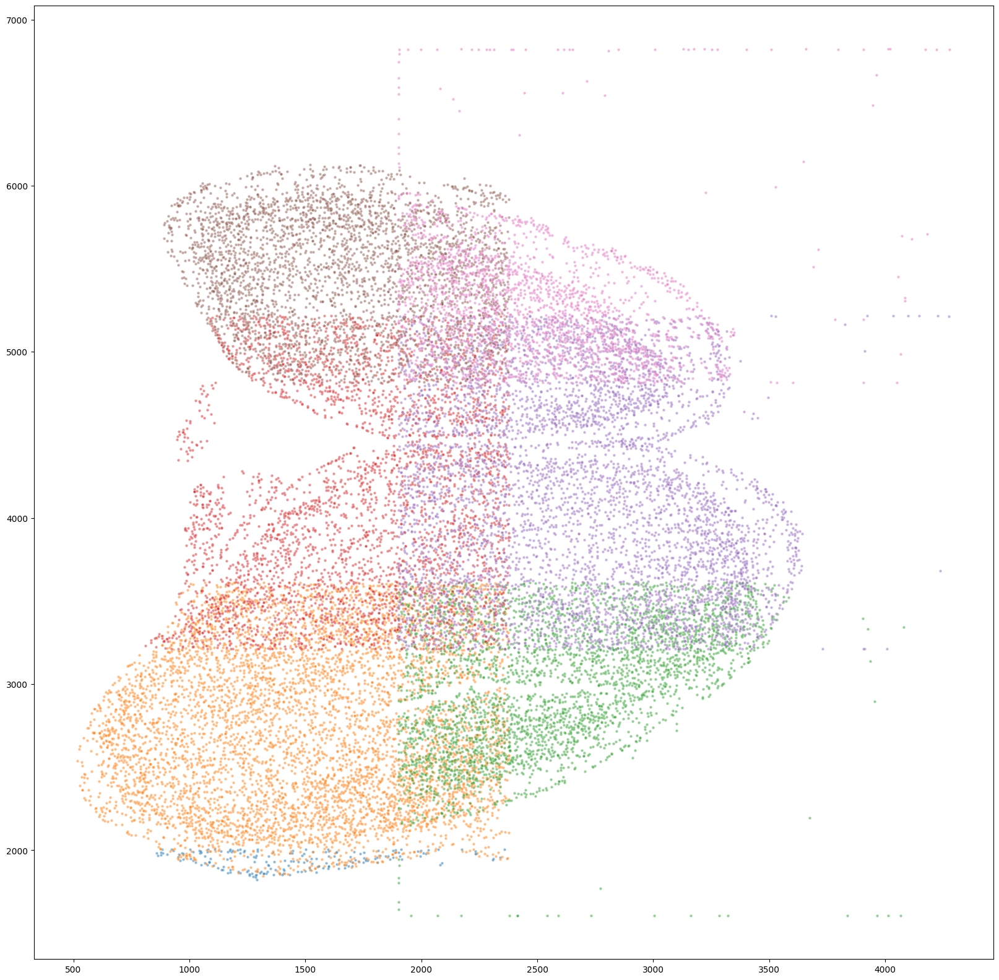

In [35]:
'''
Visualize NIS center of slice 0
'''
pt_list = []
for j in range(nrow):
    for i in range(ncol):
        pt_list.append(org_tile_pt[f'{i}-{j}'])
plot_pts(pt_list, 350, dot_size=10)
plt.show()
plt.close()

[[0, 0], [0, 1], [0, 2], [0, 3], [0, 4], [1, 4], [2, 4], [2, 3], [2, 2], [2, 1], [2, 0], [1, 0], [1, 1], [1, 2], [1, 3]]


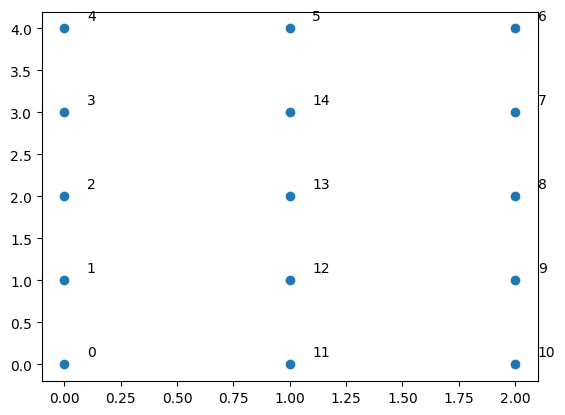

In [36]:

def spiral_coordinates(n, m):
    # Initialize boundaries
    top, bottom, left, right = 0, n - 1, 0, m - 1
    # Starting point
    i, j = 0, 0
    # Directions: right, down, left, up
    directions = [(0, 1), (1, 0), (0, -1), (-1, 0)]
    direction = 0
    result = []

    while top <= bottom and left <= right:
        # Append current coordinate
        result.append((i, j))
        # Move in the current direction
        ni, nj = i + directions[direction][0], j + directions[direction][1]
        
        if direction == 0 and nj > right:
            # Hit the right boundary, go down
            direction = 1
            top += 1
            ni, nj = i + directions[direction][0], j + directions[direction][1]
        elif direction == 1 and ni > bottom:
            # Hit the bottom boundary, go left
            direction = 2
            right -= 1
            ni, nj = i + directions[direction][0], j + directions[direction][1]
        elif direction == 2 and nj < left:
            # Hit the left boundary, go up
            direction = 3
            bottom -= 1
            ni, nj = i + directions[direction][0], j + directions[direction][1]
        elif direction == 3 and ni < top:
            # Hit the top boundary, go right
            direction = 0
            left += 1
            ni, nj = i + directions[direction][0], j + directions[direction][1]

        # Update coordinates
        i, j = ni, nj

    return result

import matplotlib.pyplot as plt
stitch_order = []
plt.figure()
for s, (i, j) in enumerate(spiral_coordinates(ncol, nrow)):
    plt.text(i+0.1, j+0.1, str(s))
    stitch_order.append([i, j])
print(stitch_order)
plt.scatter(np.array(stitch_order)[:, 0], np.array(stitch_order)[:, 1])
plt.show() 
stitch_order = stitch_order[1:]

In [37]:


def distance_mat(pt1, pt2):
    lrange = 100
    min_dis = []
    for li in range(0, len(pt1), lrange):
        d = pt1[li:li+lrange, None, :] - pt2[None, :, :]
        d = (d**2).sum(-1).sqrt()
        min_d = d.min(1)[0]
        min_dis.append(min_d)
    min_dis = torch.cat(min_dis)
    return min_dis


In [44]:
'''
Stitching from scratch by point register NIS center (tile-by-tile)
'''
# from cpd_translation import RigidRegistration

# zslice_start = int(stack_name.split('zmin')[1].split('_')[0])
# zslice_start = int(zslice_start*zratio)
# grid_mask = torch.zeros(ncol*tile_w+overlap_w+10, nrow*tile_h+overlap_h+10).bool()
new_tile_pt = {}# copy.deepcopy(tile_pt)
# for zslice in range(zslice_start, zslice_start+int(seg_shape[0]*zratio)):
# zslice = zslice_start
# print('zslice', zslice)
device = 'cuda:2'
gpu_cap_pt_num = 32000
new_tile_pt[f'{0}-{0}'] = org_tile_pt[f'{0}-{0}'].float().clone()
neighbor = [[-1, 0], [0, -1], [-1, -1], [1, 0], [0, 1], [1, 1], [1, -1], [-1, 1]]

tform_pt_reg = []
duplicated_nis_index_dict = {}
for i, j in stitch_order:
        if i==0 and j==0: 
            continue
        
        pt_mov = org_tile_pt[f'{i}-{j}'].float().clone()
        if pt_mov.shape[0] == 0:
            t_reg = torch.zeros(1, 3)
        else:
            pt_mov_w = (pt_mov[:, 1].max()-pt_mov[:, 1].min())
            pt_mov_h = (pt_mov[:, 2].max()-pt_mov[:, 2].min())
            pt_tgt = []
            pmask_tgt = []
            mov_pmasks = []
            tgt_tile_ij = []
            for pi, pj in neighbor:
                if f'{i+pi}-{j+pj}' in new_tile_pt:
                    tgt_tile_ij.append(f'{i+pi}-{j+pj}')
                    pt = new_tile_pt[f'{i+pi}-{j+pj}']
                    if pt.shape[0]!=0:
                        pt_tgt.append(pt)
                        pt_w = (pt[:, 1].max()-pt[:, 1].min())
                        pt_h = (pt[:, 2].max()-pt[:, 2].min())
                        tgt_pmasks = []
                        if pi < 0:
                            tgt_pmasks.append(pt[:, 1]>=pt[:, 1].min()+pt_w*(1-overlap_r))
                            mov_pmasks.append(pt_mov[:, 1]<=(pt_mov[:, 1].min()+pt_mov_w*(overlap_r)))
                        elif pi > 0:
                            tgt_pmasks.append(pt[:, 1]<=pt[:, 1].min()+pt_w*(overlap_r))
                            mov_pmasks.append(pt_mov[:, 1]>=(pt_mov[:, 1].min()+pt_mov_w*(1-overlap_r)))
                        if pj < 0:
                            tgt_pmasks.append(pt[:, 2]>=pt[:, 2].min()+pt_h*(1-overlap_r))
                            mov_pmasks.append(pt_mov[:, 2]<=(pt_mov[:, 2].min()+pt_mov_h*(overlap_r)))
                        elif pj > 0:
                            tgt_pmasks.append(pt[:, 2]<=pt[:, 2].min()+pt_h*(overlap_r))
                            mov_pmasks.append(pt_mov[:, 2]>=(pt_mov[:, 2].min()+pt_mov_h*(1-overlap_r)))

                        pmask = tgt_pmasks[0]
                        for m in tgt_pmasks[1:]:
                            pmask = torch.logical_and(pmask, m)

                        pmask_tgt.append(pmask)
            if len(pt_tgt) != 0:
                pt_tgt_ = torch.cat(pt_tgt)
                pmask_tgt = torch.cat(pmask_tgt)
                pmask_mov = mov_pmasks[0]
                for m in mov_pmasks:
                    pmask_mov = torch.logical_or(pmask_mov, m)

                pt_mov = pt_mov[pmask_mov, :]
                pt_tgt = pt_tgt_[pmask_tgt, :]
                
                if pt_tgt.shape[0] != 0 and pt_mov.shape[0] != 0:
                    ## downsample pt ####
                    down_r = 10
                    pt_mov = (pt_mov/down_r).long()
                    pt_tgt = (pt_tgt/down_r).long()
                    loc_unique = torch.zeros((pt_mov.max(0)[0]+1).tolist())
                    loc_unique[pt_mov[:, 0], pt_mov[:, 1], pt_mov[:, 2]] = True
                    pt_mov = torch.stack(torch.where(loc_unique), 1).float()
                    loc_unique = torch.zeros((pt_tgt.max(0)[0]+1).tolist())
                    loc_unique[pt_tgt[:, 0], pt_tgt[:, 1], pt_tgt[:, 2]] = True
                    pt_tgt = torch.stack(torch.where(loc_unique), 1).float()


                    print(datetime.now(), f'Start registration, src: [{i}-{j}], tgt: {tgt_tile_ij}')
                    # run the registration & collect the results
                    print('pt_tgt.shape', pt_tgt.shape, 'pt_mov.shape', pt_mov.shape)
                    if pt_tgt.shape[0]*pt_mov.shape[0] > gpu_cap_pt_num**2:
                        s_reg, R_reg, t_reg, correspondence = point_reg_cpd(pt_mov, pt_tgt, only_overlap=False, device='cpu')
                    else:
                        s_reg, R_reg, t_reg, correspondence = point_reg_cpd(pt_mov, pt_tgt, only_overlap=False, device=device)
                        t_reg = t_reg.cpu()
                    t_reg[0,0] = 0
                    t_reg = t_reg * down_r
                else:
                    t_reg = torch.zeros(1, 3)
            else:
                t_reg = torch.zeros(1, 3)
#         t_reg = torch.FloatTensor([[0, t_reg[0,0].item(), t_reg[0,1].item()]])
        print(datetime.now(), "Done translation:", t_reg.tolist())
        tform_pt_reg.append(t_reg[0].tolist())
#         if t_reg.isnan().any(): 
#             new_tile_pt[f'{i}-{j}'] = org_tile_pt[f'{i}-{j}'].clone().float()
#             continue
        # apply transformation to pt in a tile
        pt = org_tile_pt[f'{i}-{j}'].clone().float()
        pt = pt + t_reg
#         pmask = pt[:, 0] == zslice-zslice_start # extract 2D points
#         pt[pmask, 1:] = torch.mm(pt[pmask, 1:], R_reg) * s_reg
#         pt[pmask, 1:] = pt[pmask, 1:] + t_reg#[0]
#         pt[pmask, 2] = pt[pmask, 2] + t_reg[1]
        # remove all #########
#         mov_matched_index = pmask_mov
        # remove matched points in moving points
        ## correspondence argmax ##################################
#         mov_matched_index = correspondence.argmax(0).unique()
        ## pt-pt correspondence ###################################
#         mov_matched_index = sim_mat_to_pairwise_corr(correspondence)
#         mov_matched_index = mov_matched_index[mov_matched_index != -1]
#         mov_matched_index = torch.where(pmask)[0][torch.where(pmask_mov)[0][mov_matched_index]]
        ## distance threshold #####################################
        if pt.shape[0] != 0:
            min_dis = distance_mat(pt.to(device), pt_tgt_.to(device)).cpu()
            mov_matched_index = torch.where(min_dis<=10)[0]
    #         if pt.shape[0] > gpu_cap_pt_num or pt_tgt_.shape[0] > gpu_cap_pt_num:
    #             distance = distance_mat(pt, pt_tgt_)
    #         else:
    #             distance = distance_mat(pt.to(device), pt_tgt_.to(device)).cpu()
    #         min_dis = distance.min(1)[0]
    #         mov_matched_index = min_dis<=10
    #         mov_matched_index = torch.where(mov_matched_index)[0]
    #         print('mov_matched_index.shape', mov_matched_index.shape)
    #         duplicated_nis_index_dict[f'{i}-{j}'] = mov_matched_index
            ###########################################################
            mask = torch.ones(pt.shape[0]).bool()
            mask[mov_matched_index] = False
            pt = pt[mask]
        new_tile_pt[f'{i}-{j}'] = pt
        
        torch.cuda.empty_cache()
        
tform_pt_reg = np.array(tform_pt_reg)

2024-06-28 10:24:18.432951 Start registration, src: [0-1], tgt: ['0-0']
pt_tgt.shape torch.Size([9475, 3]) pt_mov.shape torch.Size([20057, 3])
2024-06-28 10:24:21.243866 Done translation: [[0.0, -15.792388916015625, 38.509979248046875]]
2024-06-28 10:24:21.840496 Start registration, src: [0-2], tgt: ['0-1']
pt_tgt.shape torch.Size([25933, 3]) pt_mov.shape torch.Size([24350, 3])
2024-06-28 10:24:25.824292 Done translation: [[0.0, -10.06805419921875, 30.33905029296875]]
2024-06-28 10:24:29.810226 Start registration, src: [0-3], tgt: ['0-2']
pt_tgt.shape torch.Size([21686, 3]) pt_mov.shape torch.Size([18678, 3])
2024-06-28 10:24:35.609131 Done translation: [[0.0, -12.476348876953125, 52.88665771484375]]
2024-06-28 10:24:37.892824 Start registration, src: [0-4], tgt: ['0-3']
pt_tgt.shape torch.Size([7997, 3]) pt_mov.shape torch.Size([754, 3])
2024-06-28 10:24:37.973638 Done translation: [[0.0, -47.51373291015625, -29.2169189453125]]
2024-06-28 10:24:38.020314 Start registration, src: [1-4]

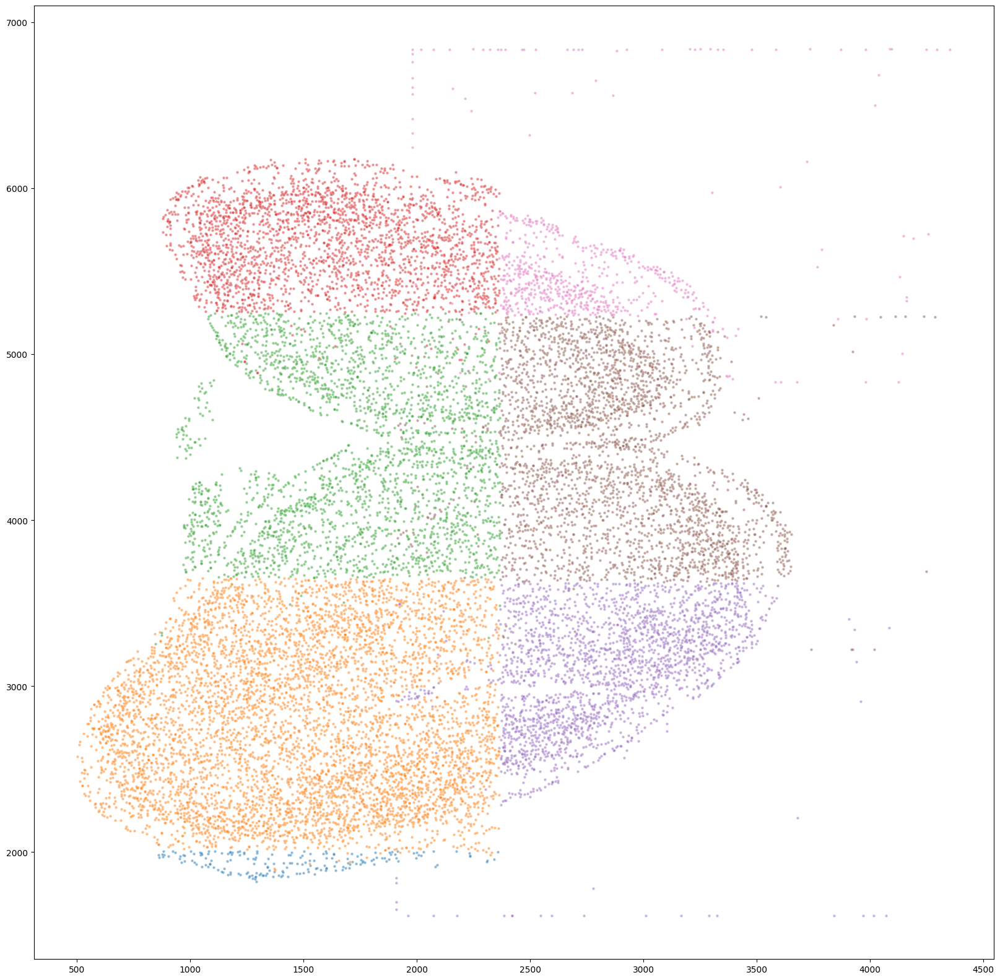

In [46]:
'''
Visualize NIS center of slice 0
'''
pt_list = []
for i in range(4):
    for j in range(5):
        if f'{i}-{j}' not in new_tile_pt: continue
        pt = new_tile_pt[f'{i}-{j}']
        pt_list.append(pt)
plot_pts(pt_list, 350, 10)
plt.show()
plt.close()

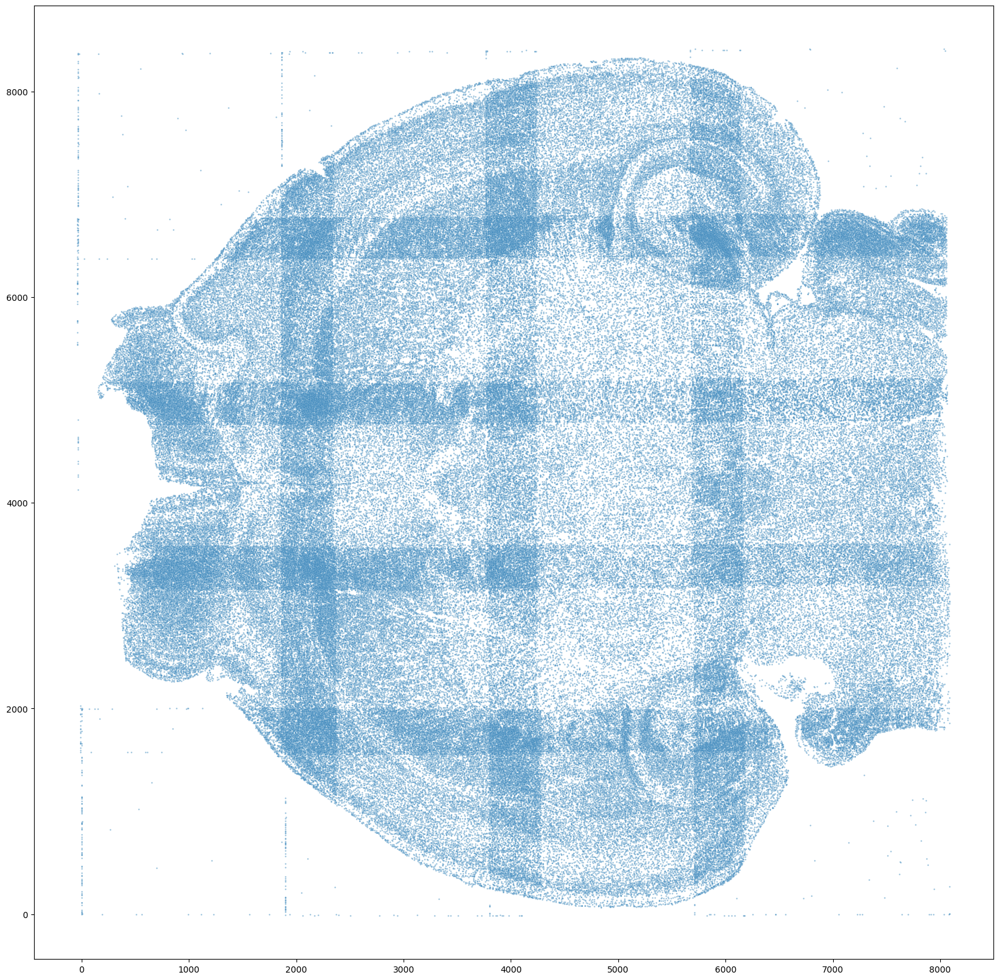

In [193]:
'''
Visualize NIS center of slice 0 (remove color)
'''
pt_list = []
for i in range(4):
    for j in range(5):
        if f'{i}-{j}' not in new_tile_pt: continue
        pt = new_tile_pt[f'{i}-{j}']
        pt_list.append(pt)
pt_list = torch.cat(pt_list)
plot_pts([pt_list])
plt.show()
plt.close()

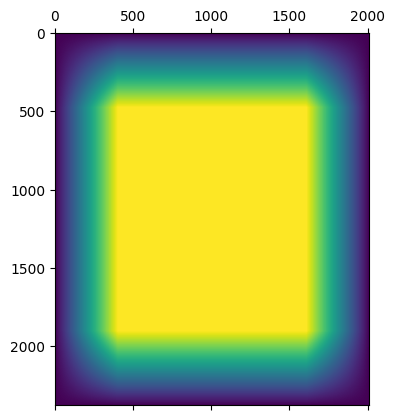

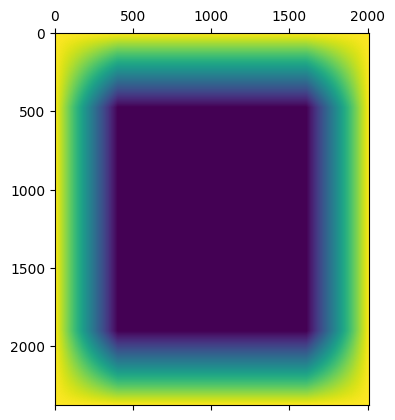

In [194]:
tile_w = int(seg_shape[1].item()*(1-overlap_r))
tile_h = int(seg_shape[2].item()*(1-overlap_r))
overlap_w = int(seg_shape[1].item()*overlap_r)
overlap_h = int(seg_shape[2].item()*overlap_r)

x_grad1 = torch.cat([torch.arange(overlap_w).float() / overlap_w, 
 torch.ones(seg_shape[1]-2*overlap_w),
 torch.arange(overlap_w, 0, -1) / overlap_w])

y_grad1 = torch.cat([torch.arange(overlap_h).float() / overlap_h, 
 torch.ones(seg_shape[2]-2*overlap_h),
 torch.arange(overlap_h, 0, -1) / overlap_h])

mov_adaptive_grad = x_grad1[:, None] * y_grad1[None, :]

x_grad2 = torch.cat([torch.arange(overlap_w, 0, -1) / overlap_w, 
 torch.zeros(seg_shape[1]-2*overlap_w),
 torch.arange(overlap_w).float() / overlap_w])

y_grad2 = torch.cat([torch.arange(overlap_h, 0, -1) / overlap_h, 
 torch.zeros(seg_shape[2]-2*overlap_h),
 torch.arange(overlap_h).float() / overlap_h])

tgt_adaptive_grad = x_grad2[:, None] * y_grad1[None, :] + x_grad1[:, None] * y_grad2[None, :] + x_grad2[:, None] * y_grad2[None, :]
# print(tgt_adaptive_grad.max(), tgt_adaptive_grad.min(), mov_adaptive_grad.max(), mov_adaptive_grad.min())
plt.matshow(mov_adaptive_grad)
plt.matshow(tgt_adaptive_grad)
def adaptive_image_stitch(mov_overlap, tgt_overlap, overlap_mask):
    overlap_coord = np.where(overlap_mask)
    if len(overlap_coord) == 3:
        _, ox, oy = overlap_coord
    else:
        ox, oy = overlap_coord
        
    mov = mov_adaptive_grad[ox, oy].numpy() * mov_overlap
    tgt = tgt_adaptive_grad[ox, oy].numpy() * tgt_overlap
    return (mov + tgt)
    

5 4 (8088, 8427) (2379, 2007)


100%|███████████████████████████████████████████████████████████████████████████████| 19/19 [00:02<00:00,  9.49it/s]


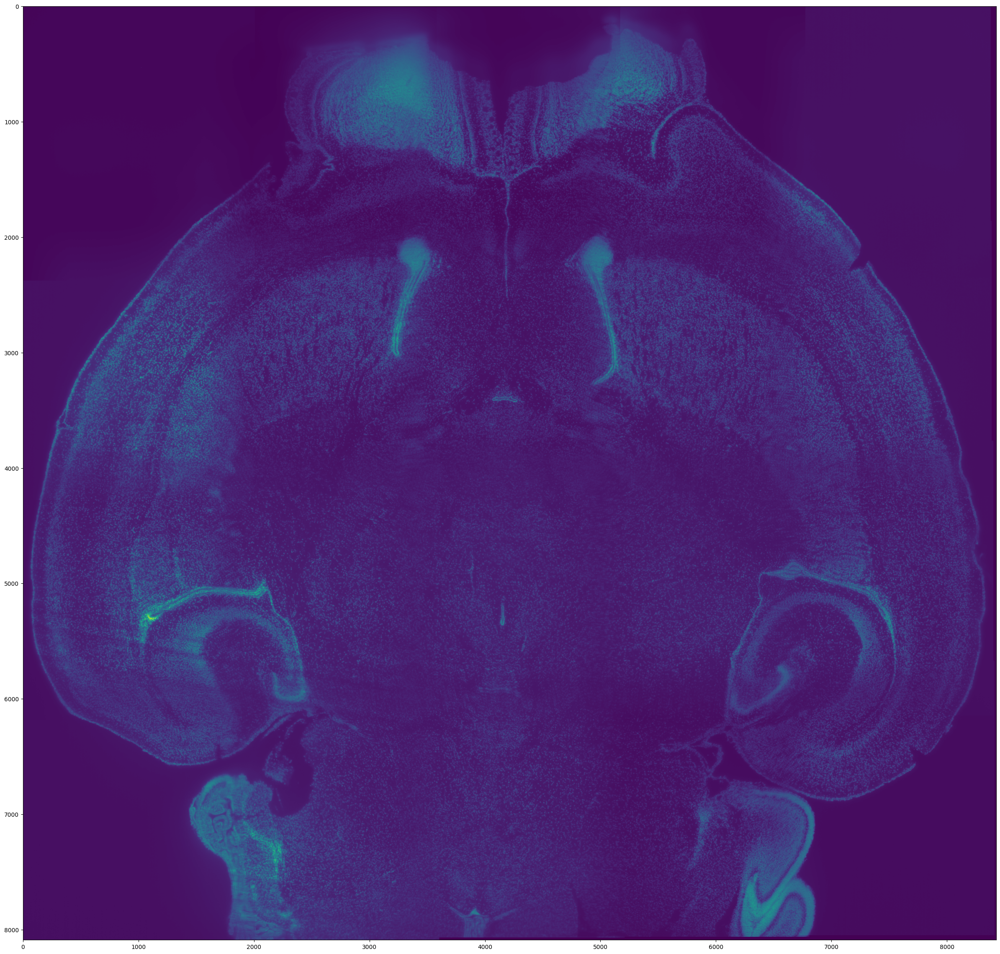

In [198]:
from PIL import Image

ls_image_root = '/lichtman/Felix/Lightsheet/P4/pair16/220805_L74D769P4_OUT_topro_ctip2_brn2_4x_11hdf_50sw_0_108na_4z_20ov_15-51-36'
fn_ = ls_image_root.split('_')[-1]+'_'+'_'.join(ls_image_root.split('/')[-1].split('_')[1:-1])

for zi in range(min(zrange,1)):
    i = j = 0
    fn = f'{fn_}_UltraII[{i:02d} x {j:02d}]_C01_xyz-Table Z{(zslice+zi):04d}.ome.tif'
    tile_img = Image.open(f'{ls_image_root}/{fn}')
    tile_img = np.asarray(tile_img)
    tile_img = (tile_img-tile_img.min())/(tile_img.max()-tile_img.min())
    wsi = np.zeros((tile_w*ncol+overlap_w+1, tile_h*nrow+overlap_h+1), dtype=tile_img.dtype)
    wsi[:tile_img.shape[0], :tile_img.shape[1]] = tile_img
    print(nrow, ncol, wsi.shape, tile_img.shape)

    wsi_stitched_by_pt = wsi.copy()
    wsi_stitched_by_nm = wsi.copy()

    pre_max_pix = None
    for tilei, (i, j) in tqdm(enumerate(stitch_order), total=len(stitch_order)):
        fn = f'{fn_}_UltraII[{i:02d} x {j:02d}]_C01_xyz-Table Z{(zslice+zi):04d}.ome.tif'
        tile_img = Image.open(f'{ls_image_root}/{fn}')
        tile_img_ = np.asarray(tile_img)
        max_pix = np.percentile(tile_img_, 99)
        if pre_max_pix is None: pre_max_pix = max_pix
        max_pix = max(max_pix, pre_max_pix)

    #     ## Without stitching ##############
    #     tile_img = (tile_img_-tile_img_.min())/(max_pix-tile_img_.min())
    #     cur_tile = wsi[tile_w*i:tile_w*(i+1)+overlap_w+1, tile_h*j:tile_h*(j+1)+overlap_h+1]
    #     fg_mask = cur_tile>0
    # #     tile_img[fg_mask] = (cur_tile[fg_mask] + tile_img[fg_mask])/2
    #     tile_img[fg_mask] = adaptive_image_stitch(tile_img[fg_mask], cur_tile[fg_mask], fg_mask)
    #     wsi[tile_w*i:tile_w*(i+1)+overlap_w+1, tile_h*j:tile_h*(j+1)+overlap_h+1] = tile_img
    #     ###################################

        ## Pt registration stitching ######
        tx, ty = tform_pt_reg[tilei, 1:]
        tx, ty = int(tx), int(ty)
        startx, endx = tile_w*i + tx, tile_w*(i+1)+overlap_w+1 + tx
        starty, endy = tile_h*j + ty, tile_h*(j+1)+overlap_h+1 + ty
        tile_img = (tile_img_-tile_img_.min())/(max_pix-tile_img_.min())
    #     print(startx, endx, starty, endy)
        if startx < 0:
            tile_img = tile_img[-startx:]
            startx = 0
        if starty < 0:
            tile_img = tile_img[:, -starty:]
            starty = 0
        if endx > wsi_stitched_by_pt.shape[0]: 
            tile_img = tile_img[:-(endx-wsi_stitched_by_pt.shape[0])]
            endx = wsi_stitched_by_pt.shape[0]
            
        if endy > wsi_stitched_by_pt.shape[1]: 
            tile_img = tile_img[:, :-(endy-wsi_stitched_by_pt.shape[1])]
            endy = wsi_stitched_by_pt.shape[1]
            
        cur_tile = wsi_stitched_by_pt[startx:endx, starty:endy]
        fg_mask = cur_tile>0
        tile_img[fg_mask] = adaptive_image_stitch(tile_img[fg_mask], cur_tile[fg_mask], fg_mask)
    #     tile_img[fg_mask] = (cur_tile[fg_mask] + tile_img[fg_mask])/2
        wsi_stitched_by_pt[startx:endx, starty:endy] = tile_img
        ###################################

    #     if tilei == 3: break

#     plt.figure(figsize=(30,30))
#     plt.imshow(wsi)
    plt.figure(figsize=(30,30))
    plt.imshow(wsi_stitched_by_pt)

In [195]:
'''
Prepare NIS properties for mask visualization
'''
root = '/cajal/ACMUSERS/ziquanw/Lightsheet/results/P4/pair16/220805_L74D769P4_OUT_topro_ctip2_brn2_4x_11hdf_50sw_0_108na_4z_20ov_15-51-36/UltraII[%02d x %02d]'
stack_name = 'L74D769P4_NIScpp_results_zmin574_instance_coordinate.zip'

tile_nis_coord = {}
for i in trange(4, desc='Load NIS coordinates'):
    for j in range(5):
        fn = f'{root % (i, j)}/{stack_name}'
        assert os.path.exists(fn), fn
        pt = torch.load(fn).long()
        pt[:, 0] = (pt[:, 0] * zratio).long()
#         pt[:, 1] = pt[:, 1] + i*seg_shape[1]*(1-overlap_r)
#         pt[:, 2] = pt[:, 2] + j*seg_shape[2]*(1-overlap_r)
        tile_nis_coord[f'{i}-{j}'] = pt
      
stack_name = 'L74D769P4_NIScpp_results_zmin574_instance_center.zip'

tile_nis_center = {}
for i in trange(4, desc='Load NIS centers'):
    for j in range(5):
        fn = f'{root % (i, j)}/{stack_name}'
        assert os.path.exists(fn), fn
        pt = torch.load(fn).long()
        pt[:, 0] = (pt[:, 0] * zratio).long()
#         pt[:, 1] = pt[:, 1] + i*seg_shape[1]*(1-overlap_r)
#         pt[:, 2] = pt[:, 2] + j*seg_shape[2]*(1-overlap_r)
        tile_nis_center[f'{i}-{j}'] = pt
        
stack_name = 'L74D769P4_NIScpp_results_zmin574_instance_volume.zip'

tile_nis_vol = {}
for i in trange(4, desc='Load NIS volume'):
    for j in range(5):
        fn = f'{root % (i, j)}/{stack_name}'
        assert os.path.exists(fn), fn
        volume = torch.load(fn).long()
        tile_nis_vol[f'{i}-{j}'] = volume
#         print(volume.shape)
        
stack_name = 'L74D769P4_NIScpp_results_zmin574_instance_label.zip'

tile_nis_label = {}
for i in trange(4, desc='Load NIS label'):
    for j in range(5):
        fn = f'{root % (i, j)}/{stack_name}'
        assert os.path.exists(fn), fn
        label = torch.load(fn).long()
        tile_nis_label[f'{i}-{j}'] = label
#         print(label.shape)

tile_nis_mask = {}
# tile_nis_bbox = {}
for k in tile_nis_label:
    center = tile_nis_center[k]
    zmask = torch.where(center[:, 0]<zrange)[0]
    vol = tile_nis_vol[k]
    label = tile_nis_label[k]
    coord = tile_nis_coord[k]
    vol_cumsum = vol.cumsum(0)
    vol_cumsum = [0] + vol_cumsum.tolist()
    coord_zmask = []
    for i in zmask:
        coord_zmask.append(torch.arange(vol_cumsum[i], vol_cumsum[i+1]))
        assert coord_zmask[-1].shape[0] == vol[i], f'{i}: {coord_zmask[-1].shape[0]} != {vol[i]}, {vol_cumsum[i-1]}, {vol_cumsum[i]}, {vol_cumsum[i+1]}'
    
    coord_zmask = torch.cat(coord_zmask)
    coord = coord[coord_zmask]
    vol = vol[zmask]
    label = label[zmask]
    
#     if k in duplicated_nis_index_dict:
#         matched_ind = duplicated_nis_index_dict[k]
#         unique_nis_ind = torch.ones(vol.shape[0]).bool()
#         unique_nis_ind[matched_ind] = False
#         unique_nis_ind = torch.where(unique_nis_ind)[0]
#         vol_cumsum = vol.cumsum(0)
#         coord_ind_unique_nis = []
#         for i in unique_nis_ind:
#             if i > 0:
#                 coord_ind_unique_nis.append(torch.arange(vol_cumsum[i-1], vol_cumsum[i]))
#             else:
#                 coord_ind_unique_nis.append(torch.arange(0, vol_cumsum[i]))
#             assert coord_ind_unique_nis[-1].shape[0] == vol[i], f'{i}: {coord_ind_unique_nis[-1].shape[0]} != {vol[i]}, {vol_cumsum[i-1]}, {vol_cumsum[i]}, {vol_cumsum[i+1]}'

#         coord_ind_unique_nis = torch.cat(coord_ind_unique_nis)
#         coord = coord[coord_ind_unique_nis]

#         mask_v = torch.repeat_interleave(label[unique_nis_ind], vol[unique_nis_ind])
#     else:
#         mask_v = torch.repeat_interleave(label, vol)
    mask_v = torch.repeat_interleave(label, vol)
    
#     bbox = coord_to_bbox(coord, vol[zmask])
    
    print(mask_v.shape, coord.shape, mask_v.max())
    
    mask = np.zeros((coord[:, 0].max()+1, seg_shape[1], seg_shape[2]))
    mask[coord[:, 0], coord[:, 1], coord[:, 2]] = mask_v
#     print(k, bbox[:3], len(np.unique(mask)))
    tile_nis_mask[k] = mask

Load NIS label: 100%|████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 140.82it/s]


torch.Size([5254197]) torch.Size([5254197, 3]) tensor(88119)
torch.Size([32332693]) torch.Size([32332693, 3]) tensor(1082998)
torch.Size([35032285]) torch.Size([35032285, 3]) tensor(1524652)
torch.Size([33859464]) torch.Size([33859464, 3]) tensor(1011374)
torch.Size([6904251]) torch.Size([6904251, 3]) tensor(137932)
torch.Size([30602430]) torch.Size([30602430, 3]) tensor(913289)
torch.Size([45576910]) torch.Size([45576910, 3]) tensor(2171543)
torch.Size([41309890]) torch.Size([41309890, 3]) tensor(2407708)
torch.Size([44487280]) torch.Size([44487280, 3]) tensor(2286056)
torch.Size([32432494]) torch.Size([32432494, 3]) tensor(1081928)
torch.Size([39390266]) torch.Size([39390266, 3]) tensor(1429425)
torch.Size([32365607]) torch.Size([32365607, 3]) tensor(1566166)
torch.Size([34475877]) torch.Size([34475877, 3]) tensor(2003416)
torch.Size([33747639]) torch.Size([33747639, 3]) tensor(1790047)
torch.Size([38984318]) torch.Size([38984318, 3]) tensor(1714887)
torch.Size([15554250]) torch.Size

In [178]:
import torchvision
from torchvision.ops import masks_to_boxes
from torchvision.ops._utils import _upcast

def mask_to_bbox(mask):
    mask = mask.long()
    obj_ids = torch.unique(mask)[1:]
#     masks = mask == obj_ids[:, None, None]
#     bbox = masks_to_boxes(masks)

    bbox = []
    for i in obj_ids:
        coord = torch.stack(torch.where(mask==i))
        bbox.append(torch.cat([coord.min(1)[0], coord.max(1)[0]]))
    bbox = torch.stack(bbox)

    return bbox

def mask_remove_ind(mask, ind_list):
#     if len(mask.shape) == 2:
#         masks = mask == ind_list[:, None, None]
#     elif len(mask.shape) == 3:
#         masks = mask == ind_list[:, None, None, None]
#     remove = masks.any(0)
#     mask[remove] = 0
#     return mask
    for i in ind_list:
        mask[mask==i] = 0
    return mask

def box_area(bbox, D):
    bbox = _upcast(bbox)
    wh = bbox[:, D:] - bbox[:, :D]
    return torch.cumprod(wh, dim=1)[:, -1]

# implementation from https://github.com/kuangliu/torchcv/blob/master/torchcv/utils/box.py
# with slight modifications
def box_iou(boxes1, boxes2, D=2, area1=None, area2=None):
    if area1 is None:
        area1 = box_area(boxes1, D)
    if area2 is None:
        area2 = box_area(boxes2, D)
    lt = torch.max(boxes1[:, None, :D], boxes2[:, :D])  # [N,M,D]
    rb = torch.min(boxes1[:, None, D:], boxes2[:, D:])  # [N,M,D]
    wh = _upcast(rb - lt).clamp(min=0)  # [N,M,D]
    inter = wh.cumprod(-1)[..., -1]  # [N,M]
    union = area1[:, None] + area2 - inter
    iou = inter / union
    return iou

def nms_nis_masks(mask_tgt, mask_mov, iou_threshold=0.1, bbox_tgt=None, bbox_mov=None):

    if bbox_tgt is None:
        bbox_tgt = mask_to_bbox(mask_tgt)
    if bbox_mov is None:
        bbox_mov = mask_to_bbox(mask_mov)
    D = len(mask_tgt.shape)
    area_tgt = box_area(bbox_tgt, D)
    area_mov = box_area(bbox_mov, D)
    iou = box_iou(bbox_tgt, bbox_mov, D, area1=area_tgt, area2=area_mov)
    remove_ind_tgt, remove_ind_mov = torch.where(iou>=iou_threshold)
    ## remove small area of tgt or mov bbox
    remove_area_tgt = area_tgt[remove_ind_tgt] 
    remove_area_mov = area_mov[remove_ind_mov] 
    remove_ind_tgt = remove_ind_tgt[remove_area_tgt < remove_area_mov].unique()
    remove_ind_mov = remove_ind_mov[remove_area_mov <= remove_area_tgt].unique()
    ## remap box index to mask index
    remove_ind_tgt = mask_tgt.unique()[1:][remove_ind_tgt]
    remove_ind_mov = mask_mov.unique()[1:][remove_ind_mov]
    
    print("bbox_tgt.shape, bbox_mov.shape", bbox_tgt.shape, bbox_mov.shape)
    print("remove_ind_tgt.shape, remove_ind_mov.shape", remove_ind_tgt.shape, remove_ind_mov.shape)
    mask_tgt = mask_remove_ind(mask_tgt, remove_ind_tgt)
    mask_mov = mask_remove_ind(mask_mov, remove_ind_mov)
    
    return mask_tgt, mask_mov

5 4 (8088, 8427) (2379, 2007) 2497


  0%|                                                                                        | 0/19 [00:00<?, ?it/s]

87954.0 913192.0


  5%|████▏                                                                           | 1/19 [00:01<00:21,  1.19s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([1822, 4]) torch.Size([15155, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([739]) torch.Size([774])
913192.0 1429423.0


 11%|████████▍                                                                       | 2/19 [00:02<00:25,  1.51s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([4087, 4]) torch.Size([20589, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1522]) torch.Size([1811])
1429326.0 383636.0


 16%|████████████▋                                                                   | 3/19 [00:03<00:20,  1.27s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([3912, 4]) torch.Size([8344, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1638]) torch.Size([1927])
912777.0 1082940.0


 21%|████████████████▊                                                               | 4/19 [00:05<00:20,  1.34s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([1728, 4]) torch.Size([18434, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([863]) torch.Size([588])
1082923.0 1523731.0
bbox_tgt.shape, bbox_mov.shape torch.Size([5450, 4]) torch.Size([20423, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([2649]) torch.Size([1943])


 26%|█████████████████████                                                           | 5/19 [00:07<00:21,  1.52s/it]

1523731.0 1011374.0


 32%|█████████████████████████▎                                                      | 6/19 [00:08<00:20,  1.60s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([4834, 4]) torch.Size([17860, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([2518]) torch.Size([1489])
1011120.0 137677.0


 37%|█████████████████████████████▍                                                  | 7/19 [00:09<00:14,  1.23s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([2153, 4]) torch.Size([3277, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1010]) torch.Size([815])
1009960.0 1081920.0


 42%|█████████████████████████████████▋                                              | 8/19 [00:10<00:13,  1.25s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([2291, 4]) torch.Size([16241, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([805]) torch.Size([1206])
1081838.0 1714887.0


 47%|█████████████████████████████████████▉                                          | 9/19 [00:12<00:14,  1.42s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([4262, 4]) torch.Size([19999, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1718]) torch.Size([2094])
1714746.0 677871.0


 53%|█████████████████████████████████████████▌                                     | 10/19 [00:13<00:12,  1.35s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([3936, 4]) torch.Size([11960, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1426]) torch.Size([1857])
1714572.0 1513762.0
bbox_tgt.shape, bbox_mov.shape torch.Size([5589, 4]) torch.Size([21153, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([2145]) torch.Size([3130])


 58%|█████████████████████████████████████████████▋                                 | 11/19 [00:15<00:12,  1.56s/it]

1513624.0 1633975.0


 63%|█████████████████████████████████████████████████▉                             | 12/19 [00:17<00:10,  1.54s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([3079, 4]) torch.Size([17864, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1177]) torch.Size([1826])
1633962.0 1188323.0
bbox_tgt.shape, bbox_mov.shape torch.Size([6830, 4]) torch.Size([17327, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([2445]) torch.Size([2773])


 68%|██████████████████████████████████████████████████████                         | 13/19 [00:19<00:09,  1.65s/it]

1523679.0 2171520.0
bbox_tgt.shape, bbox_mov.shape torch.Size([10329, 4]) torch.Size([24654, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([4454]) torch.Size([4591])


 74%|██████████████████████████████████████████████████████████▏                    | 14/19 [00:21<00:09,  1.95s/it]

2171305.0 1566166.0
bbox_tgt.shape, bbox_mov.shape torch.Size([10263, 4]) torch.Size([16753, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([3711]) torch.Size([3663])


 79%|██████████████████████████████████████████████████████████████▎                | 15/19 [00:23<00:08,  2.02s/it]

2171520.0 2407706.0
bbox_tgt.shape, bbox_mov.shape torch.Size([10247, 4]) torch.Size([22756, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([4074]) torch.Size([4090])


 84%|██████████████████████████████████████████████████████████████████▌            | 16/19 [00:26<00:06,  2.19s/it]

2407586.0 2003410.0
bbox_tgt.shape, bbox_mov.shape torch.Size([9604, 4]) torch.Size([16509, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([3282]) torch.Size([3410])


 89%|██████████████████████████████████████████████████████████████████████▋        | 17/19 [00:28<00:04,  2.13s/it]

2407706.0 2286056.0
bbox_tgt.shape, bbox_mov.shape torch.Size([14135, 4]) torch.Size([24490, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([5903]) torch.Size([6416])


 95%|██████████████████████████████████████████████████████████████████████████▊    | 18/19 [00:31<00:02,  2.43s/it]

2407586.0 1789882.0
bbox_tgt.shape, bbox_mov.shape torch.Size([12140, 4]) torch.Size([17029, 4])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([3797]) torch.Size([4766])


100%|███████████████████████████████████████████████████████████████████████████████| 19/19 [00:34<00:00,  1.82s/it]


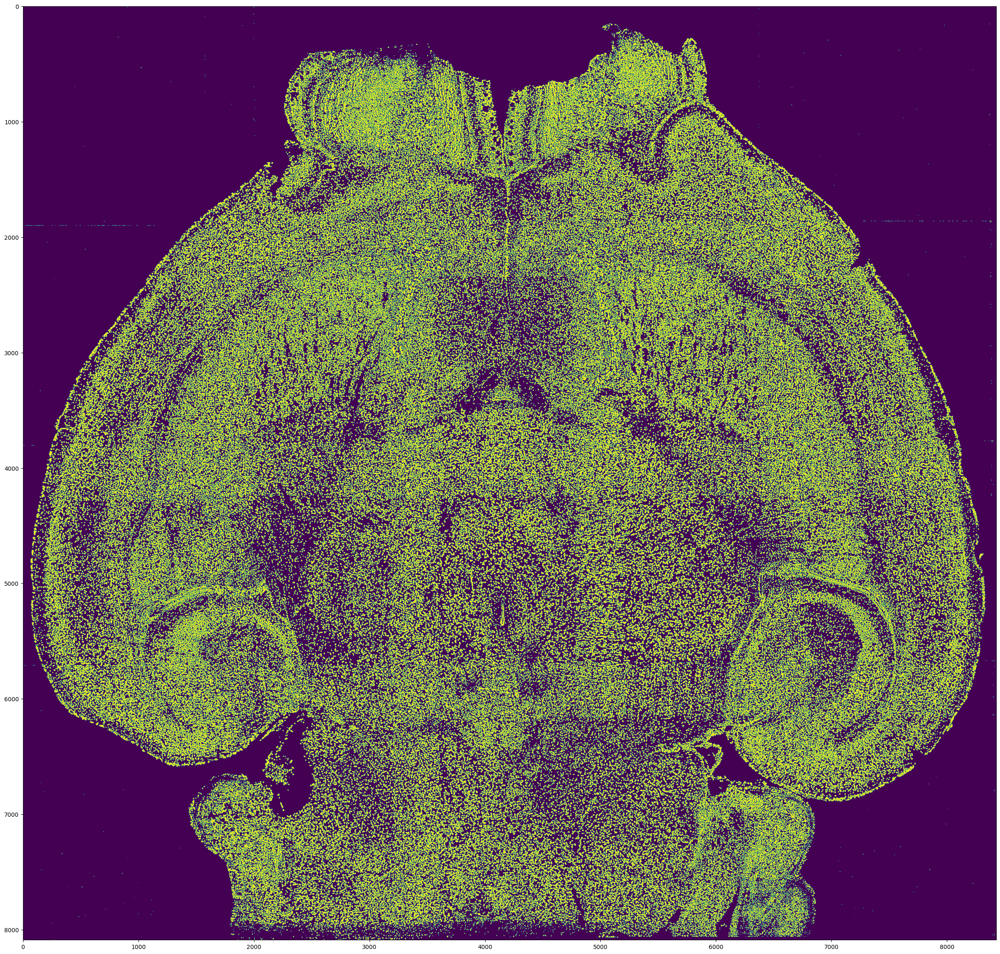

In [196]:
from PIL import Image
tile_w = int(seg_shape[1].item()*(1-overlap_r))
tile_h = int(seg_shape[2].item()*(1-overlap_r))
overlap_w = int(seg_shape[1].item()*overlap_r)
overlap_h = int(seg_shape[2].item()*overlap_r)
device = 'cuda:1'
for z in range(1):
    i = j = 0
    tile_img = tile_nis_mask[f'{i}-{j}'][z]
    nis_mask = np.zeros((tile_w*ncol+overlap_w+1, tile_h*nrow+overlap_h+1), dtype=tile_img.dtype)
    nis_mask[:tile_img.shape[0], :tile_img.shape[1]] = tile_img
    print(nrow, ncol, nis_mask.shape, tile_img.shape, len(np.unique(tile_img)))

    nis_mask_stitched_by_pt = nis_mask.copy()
    for tilei, (i, j) in tqdm(enumerate(stitch_order), total=len(stitch_order)):

        tile_img_ = tile_nis_mask[f'{i}-{j}'][z]

        ## Pt registration stitching ######
        tx, ty = tform_pt_reg[tilei, 1:]
        tx, ty = int(tx), int(ty)
        startx, endx = tile_w*i + tx, tile_w*(i+1)+overlap_w+1 + tx
        starty, endy = tile_h*j + ty, tile_h*(j+1)+overlap_h+1 + ty
        tile_img = tile_img_.copy()
        if startx < 0:
            tile_img = tile_img[-startx:]
            startx = 0
        if starty < 0:
            tile_img = tile_img[:, -starty:]
            starty = 0
        if endx > wsi_stitched_by_pt.shape[0]: 
            tile_img = tile_img[:-(endx-wsi_stitched_by_pt.shape[0])]
            endx = wsi_stitched_by_pt.shape[0]
        if endy > wsi_stitched_by_pt.shape[1]: 
            tile_img = tile_img[:, :-(endy-wsi_stitched_by_pt.shape[1])]
            endy = wsi_stitched_by_pt.shape[1]
            
            
        cur_tile = nis_mask_stitched_by_pt[startx:endx, starty:endy]
        print(cur_tile.max(), tile_img.max())
    #     ### remove duplicated by IoU ######
        cur_tile, tile_img = nms_nis_masks(
            torch.from_numpy(cur_tile).to(device), 
            torch.from_numpy(tile_img).to(device),
            iou_threshold=0.1
        )
        cur_tile, tile_img = cur_tile.cpu().numpy(), tile_img.cpu().numpy()
#     #     ###################################
        fg_mask = cur_tile>0
        tile_img[fg_mask] = cur_tile[fg_mask] #
# #         tile_img[fg_mask] = np.maximum(cur_tile[fg_mask], tile_img[fg_mask])
        nis_mask_stitched_by_pt[startx:endx, starty:endy] = tile_img
        ###################################
    #     if tilei == 3: break
    
        torch.cuda.empty_cache()

    nis_mask_stitched_by_pt_binary = nis_mask_stitched_by_pt.copy()
    nis_mask_stitched_by_pt_binary[nis_mask_stitched_by_pt>0] = 1

    nib.save(nib.Nifti1Image(nis_mask_stitched_by_pt[None], np.eye(4)), f'/ram/USERS/ziquanw/Lightsheet_microscopy_image_3D_nuclei_instance_segmentation/downloads/pt-reg-stitched-nismask3d_{fn_}_Z{(zslice+z):04d}.nii.gz')
    nib.save(nib.Nifti1Image(nis_mask_stitched_by_pt_binary[None], np.eye(4)), f'/ram/USERS/ziquanw/Lightsheet_microscopy_image_3D_nuclei_instance_segmentation/downloads/pt-reg-stitched-bmask3d_{fn_}_Z{(zslice+z):04d}.nii.gz')
    
    plt.figure(figsize=(30,30))
    plt.imshow(nis_mask_stitched_by_pt_binary)

In [183]:

i = j = 0
tile_img = tile_nis_mask[f'{i}-{j}'][:zrange]
nis_mask = np.zeros((tile_img.shape[0], tile_w*ncol+overlap_w+1, tile_h*nrow+overlap_h+1), dtype=tile_img.dtype)
nis_mask[:, :tile_img.shape[1], :tile_img.shape[2]] = tile_img
print(nrow, ncol, nis_mask.shape, tile_img.shape, len(np.unique(tile_img)))

nis_mask_stitched_by_pt = nis_mask.copy()
for tilei, (i, j) in tqdm(enumerate(stitch_order), total=len(stitch_order)):

    tile_img_ = tile_nis_mask[f'{i}-{j}'][:zrange]

    ## Pt registration stitching ######
    tx, ty = tform_pt_reg[tilei, 1:]
    tx, ty = int(tx), int(ty)
    startx, endx = tile_w*i + tx, tile_w*(i+1)+overlap_w+1 + tx
    starty, endy = tile_h*j + ty, tile_h*(j+1)+overlap_h+1 + ty
    tile_img = tile_img_.copy()
    if startx < 0:
        tile_img = tile_img[:, -startx:]
        startx = 0
    if starty < 0:
        tile_img = tile_img[:, :, -starty:]
        starty = 0
    if endx > nis_mask_stitched_by_pt.shape[1]: 
        tile_img = tile_img[:, :-(endx-nis_mask_stitched_by_pt.shape[1])]
        endx = nis_mask_stitched_by_pt.shape[1]
    if endy > nis_mask_stitched_by_pt.shape[2]: 
        tile_img = tile_img[:, :, :-(endy-nis_mask_stitched_by_pt.shape[2])]
        endy = nis_mask_stitched_by_pt.shape[2]
            
    cur_tile = nis_mask_stitched_by_pt[:, startx:endx, starty:endy]
#     ### remove duplicated by IoU ######
    cur_tile, tile_img = nms_nis_masks(
        torch.from_numpy(cur_tile).to(device), 
        torch.from_numpy(tile_img).to(device),
        iou_threshold=0.03
    )
    cur_tile, tile_img = cur_tile.cpu().numpy(), tile_img.cpu().numpy()
#     ###################################
    fg_mask = cur_tile>0
    tile_img[fg_mask] = cur_tile[fg_mask] #
#     tile_img[fg_mask] = np.maximum(cur_tile[fg_mask], tile_img[fg_mask])
    nis_mask_stitched_by_pt[:, startx:endx, starty:endy] = tile_img
    ###################################
#     if tilei == 3: break
    torch.cuda.empty_cache()

nis_mask_stitched_by_pt_binary = nis_mask_stitched_by_pt.copy()
nis_mask_stitched_by_pt_binary[nis_mask_stitched_by_pt>0] = 1
nib.save(nib.Nifti1Image(nis_mask_stitched_by_pt, np.eye(4)), f'/ram/USERS/ziquanw/Lightsheet_microscopy_image_3D_nuclei_instance_segmentation/downloads/pt-reg-stitched-nismask3d_{fn_}_Z{zslice:04d}-{(zslice+zrange):04d}.nii.gz')
nib.save(nib.Nifti1Image(nis_mask_stitched_by_pt_binary, np.eye(4)), f'/ram/USERS/ziquanw/Lightsheet_microscopy_image_3D_nuclei_instance_segmentation/downloads/pt-reg-stitched-bmask3d_{fn_}_Z{zslice:04d}-{(zslice+zrange):04d}.nii.gz')

5 4 (5, 8088, 8427) (5, 2379, 2007) 4731


  0%|                                                                                        | 0/19 [00:00<?, ?it/s]

bbox_tgt.shape, bbox_mov.shape torch.Size([3342, 6]) torch.Size([29292, 6])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1833]) torch.Size([1818])


  5%|████▏                                                                           | 1/19 [00:15<04:43, 15.75s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([7699, 6]) torch.Size([39101, 6])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([3722]) torch.Size([4016])


 11%|████████▍                                                                       | 2/19 [00:40<05:53, 20.77s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([7287, 6]) torch.Size([16147, 6])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([3924]) torch.Size([4152])


 16%|████████████▋                                                                   | 3/19 [00:55<04:54, 18.41s/it]

bbox_tgt.shape, bbox_mov.shape torch.Size([2891, 6]) torch.Size([35806, 6])
remove_ind_tgt.shape, remove_ind_mov.shape torch.Size([1250]) torch.Size([1361])


 21%|████████████████▊                                                               | 4/19 [01:33<05:49, 23.31s/it]


OutOfMemoryError: CUDA out of memory. Tried to allocate 10.04 GiB (GPU 0; 47.51 GiB total capacity; 32.48 GiB already allocated; 9.98 GiB free; 36.13 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [197]:

tile_w = int(seg_shape[1].item()*(1-overlap_r))
tile_h = int(seg_shape[2].item()*(1-overlap_r))
overlap_w = int(seg_shape[1].item()*overlap_r)
overlap_h = int(seg_shape[2].item()*overlap_r)
ls_image_root = '/lichtman/Felix/Lightsheet/P4/pair16/220805_L74D769P4_OUT_topro_ctip2_brn2_4x_11hdf_50sw_0_108na_4z_20ov_15-51-36'
fn_ = ls_image_root.split('_')[-1]+'_'+'_'.join(ls_image_root.split('/')[-1].split('_')[1:-1])

wsi3d_stitched_by_pt = np.zeros((zrange, tile_w*ncol+overlap_w+1, tile_h*nrow+overlap_h+1), dtype=tile_img.dtype)

for zi in range(1):

    i = j = 0
    fn = f'{fn_}_UltraII[{i:02d} x {j:02d}]_C01_xyz-Table Z{(zslice+zi):04d}.ome.tif'
    tile_img = Image.open(f'{ls_image_root}/{fn}')
    tile_img = np.asarray(tile_img)
    tile_img = (tile_img-tile_img.min())/(tile_img.max()-tile_img.min())
    wsi3d_stitched_by_pt[zi, :tile_img.shape[0], :tile_img.shape[1]] = tile_img
    print(nrow, ncol, wsi.shape, tile_img.shape)


    pre_max_pix = None
    for tilei, (i, j) in tqdm(enumerate(stitch_order), total=len(stitch_order)):
        fn = f'{fn_}_UltraII[{i:02d} x {j:02d}]_C01_xyz-Table Z{(zslice+zi):04d}.ome.tif'
        tile_img = Image.open(f'{ls_image_root}/{fn}')
        tile_img_ = np.asarray(tile_img)
        max_pix = np.percentile(tile_img_, 99)
        if pre_max_pix is None: pre_max_pix = max_pix
        max_pix = max(max_pix, pre_max_pix)

        ## Pt registration stitching ######
        tx, ty = tform_pt_reg[tilei, 1:]
        tx, ty = int(tx), int(ty)
        startx, endx = tile_w*i + tx, tile_w*(i+1)+overlap_w+1 + tx
        starty, endy = tile_h*j + ty, tile_h*(j+1)+overlap_h+1 + ty
        tile_img = (tile_img_-tile_img_.min())/(max_pix-tile_img_.min())
    #     print(startx, endx, starty, endy)
        if startx < 0:
            tile_img = tile_img[-startx:]
            startx = 0
        if starty < 0:
            tile_img = tile_img[:, -starty:]
            starty = 0
        if endx > wsi3d_stitched_by_pt.shape[1]: 
            tile_img = tile_img[:-(endx-wsi3d_stitched_by_pt.shape[1])]
            endx = wsi3d_stitched_by_pt.shape[1]
        if endy > wsi3d_stitched_by_pt.shape[2]: 
            tile_img = tile_img[:, :-(endy-wsi3d_stitched_by_pt.shape[2])]
            endy = wsi3d_stitched_by_pt.shape[2]
            
        cur_tile = wsi3d_stitched_by_pt[zi, startx:endx, starty:endy]
        fg_mask = cur_tile>0
#         tile_img[fg_mask] = (cur_tile[fg_mask] + tile_img[fg_mask])/2
        tile_img[fg_mask] = adaptive_image_stitch(tile_img[fg_mask], cur_tile[fg_mask], fg_mask)
        wsi3d_stitched_by_pt[zi, startx:endx, starty:endy] = tile_img
        ###################################
        
    
    nib.save(nib.Nifti1Image(wsi3d_stitched_by_pt[zi:zi+1], np.eye(4)), f'/ram/USERS/ziquanw/Lightsheet_microscopy_image_3D_nuclei_instance_segmentation/downloads/pt-reg-stitched-ls3d_{fn_}_Z{(zslice+zi):04d}.nii.gz')
    

nib.save(nib.Nifti1Image(wsi3d_stitched_by_pt, np.eye(4)), f'/ram/USERS/ziquanw/Lightsheet_microscopy_image_3D_nuclei_instance_segmentation/downloads/pt-reg-stitched-ls3d_{fn_}_Z{zslice:04d}-{(zslice+zrange):04d}.nii.gz')

5 4 (8088, 8427) (2379, 2007)


100%|███████████████████████████████████████████████████████████████████████████████| 19/19 [00:01<00:00,  9.58it/s]


In [19]:
tform_pt_reg

array([[  0.        ,  -3.47094727, -12.26391602],
       [  0.        ,  -1.97436523, -19.46191406],
       [  0.        ,  -2.17724609,  -9.38171387],
       [  0.        , -14.50537109, -26.58435059],
       [  0.        , -42.96228027, -51.8293457 ],
       [  0.        , -44.3626709 , -55.828125  ],
       [  0.        , -43.84484863, -55.33398438],
       [  0.        , -58.74414062, -42.79492188],
       [  0.        , -57.27563477, -21.17578125],
       [  0.        , -55.53125   , -13.46533203],
       [  0.        , -43.75097656,  -8.12255859],
       [  0.        , -37.83300781,  -0.42431641],
       [  0.        ,  -6.17871094, -11.81738281],
       [  0.        , -39.5144043 , -50.11694336],
       [  0.        , -15.82421875, -17.0793457 ],
       [  0.        , -48.16918945, -57.74853516],
       [  0.        , -39.58300781, -29.67749023],
       [  0.        , -49.90942383, -49.53417969],
       [  0.        , -42.32714844, -29.02246094]])